<a href="https://colab.research.google.com/github/lumagallacio/covid-19-analysis/blob/master/covid_19_br_analysis.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Get data from Dataset
https://brasil.io/dataset/covid19/caso/

In [0]:
import pandas as pd
import numpy as np

In [0]:
df = pd.read_csv("https://brasil.io/dataset/covid19/caso/?format=csv")


In [0]:
df.head()

,date,state,city,place_type,confirmed,deaths,is_last,estimated_population_2019,city_ibge_code,confirmed_per_100k_inhabitants,death_rate
0,2020-05-15,AC,Acrelândia,city,59,1,True,15256.0,1200013.0,386.73309,0.0169
1,2020-05-15,AC,Assis Brasil,city,1,0,True,7417.0,1200054.0,13.48254,0.0000
2,2020-05-15,AC,Brasiléia,city,3,0,True,26278.0,1200104.0,11.41639,0.0000
3,2020-05-15,AC,Bujari,city,17,0,True,10266.0,1200138.0,165.59517,0.0000
4,2020-05-15,AC,Capixaba,city,2,0,True,11733.0,1200179.0,17.04594,0.0000


In [0]:
states = df.loc[df.place_type=='state',:]
states.state.unique()

array(['AC', 'AL', 'AP', 'CE', 'DF', 'GO', 'MA', 'MG', 'PA', 'PB', 'PE',
       'PI', 'PR', 'RJ', 'RO', 'RR', 'RS', 'SC', 'SP', 'AM', 'BA', 'ES',
       'MS', 'MT', 'SE', 'TO', 'RN'], dtype=object)

In [0]:
data = states[['date','state','confirmed', 'deaths', 'confirmed_per_100k_inhabitants','death_rate', 'is_last']]
data.head()

,date,state,confirmed,deaths,confirmed_per_100k_inhabitants,death_rate,is_last
22,2020-05-15,AC,1785,57,202.39587,0.0319,True
100,2020-05-15,AL,3212,187,96.24382,0.0582,True
118,2020-05-15,AP,3630,103,429.21449,0.0284,True
295,2020-05-15,CE,23059,1566,252.50551,0.0679,True
298,2020-05-15,DF,3787,55,125.59414,0.0145,True


How was the evolution of covid-19 in each Brazilian state?

In [0]:
from matplotlib import cm
def plot_covid(covid, ylabel):
    cmap = cm.get_cmap('hsv') 
    fig = covid.plot(figsize=(12, 8),cmap=cmap)
    fig.set_xlabel("day")
    fig.set_ylabel(ylabel)
    fig.legend(bbox_to_anchor=(1.1, 0.9))
    

In [0]:
def since_first_case(data, states, days, situation):  
    covid = pd.DataFrame()
    for state in states:
        try:
            df_state = data.loc[data.state==state,:]
            
            df_state = df_state.groupby('date').sum()[situation].reset_index()
            
            df_state = df_state.drop('date',axis=1)
            covid = pd.concat([covid, df_state], ignore_index= False, axis=1)
        except:
            print("Error - "+ situation + ' in '+ state)
        
    covid.columns = states
    return covid.head(days)

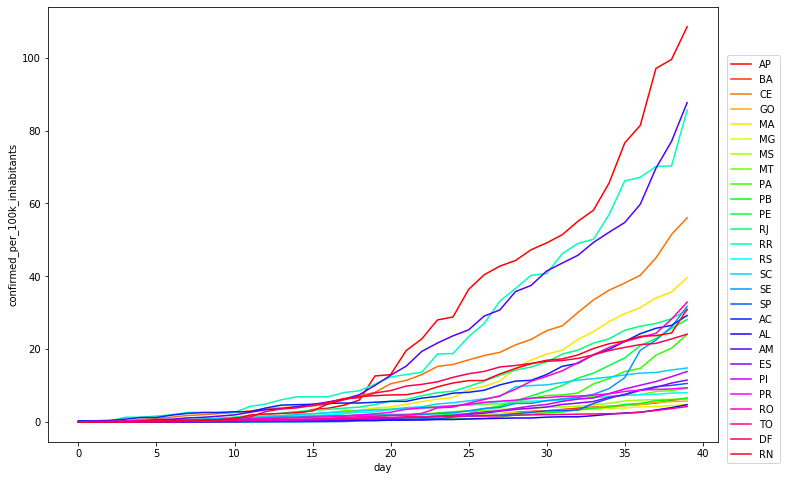

In [0]:
df_states = since_first_case(data, ['AP', 'BA', 'CE', 'GO', 'MA', 'MG', 'MS', 'MT', 'PA', 'PB', 'PE',
       'RJ', 'RR', 'RS', 'SC', 'SE', 'SP', 'AC', 'AL', 'AM', 'ES', 'PI',
       'PR', 'RO', 'TO', 'DF', 'RN'], 40, 'confirmed_per_100k_inhabitants')
plot_covid(df_states, 'confirmed_per_100k_inhabitants')

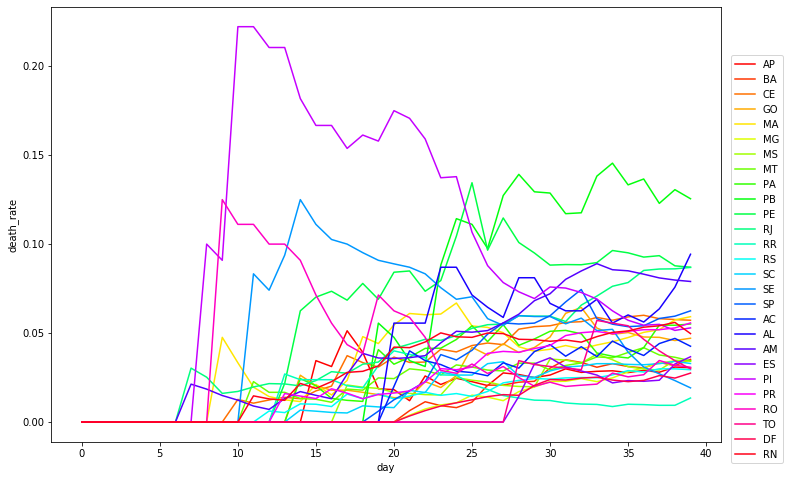

In [0]:
df_states = since_first_case(data, ['AP', 'BA', 'CE', 'GO', 'MA', 'MG', 'MS', 'MT', 'PA', 'PB', 'PE',
       'RJ', 'RR', 'RS', 'SC', 'SE', 'SP', 'AC', 'AL', 'AM', 'ES', 'PI',
       'PR', 'RO', 'TO', 'DF', 'RN'], 40, 'death_rate')
plot_covid(df_states, 'death_rate')

Heatmap of states

In [0]:
last_cases = states.loc[states.is_last==True, ['state','deaths']]
last_cases_map = last_cases.set_index('state')['deaths']

import folium
from folium import plugins
import branca
import requests
import json
from branca import colormap as cm
from branca.colormap import linear

colormap = linear.YlOrRd_09.scale(0, 5000)
colormap = cm.LinearColormap(
    ['blue', 'yellow', 'red'],
    vmin=0, vmax=5000
)

geo_json_data = json.loads(requests.get(f'https://raw.githubusercontent.com/sandeco/CanalSandeco/master/covid-19/br_states.json').text)


mapa = folium.Map(
    width=600, height=400,
    location=[-15.77972, -47.92972], 
    zoom_start=4
)

folium.GeoJson(
    geo_json_data,
    name='COVID-19',
    style_function = lambda feature: {
        'fillColor': colormap(last_cases_map[feature['id']]),
        'color': 'black',
        'weight': 0.9,
    }
    
).add_to(mapa)
colormap.caption = 'Covid-19 deaths by states'
colormap.add_to(mapa)

mapa

linear regression SP

,confirmed,deaths
confirmed,1.000000,0.998699
deaths,0.998699,1.000000


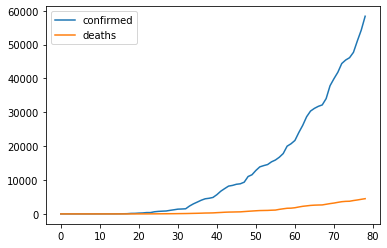

In [0]:
#The two variables are well correlated
df_corr = pd.DataFrame()

def correlation_case_death(data, state, days):
    df_corr         = pd.DataFrame()
    sp_confirmed    = since_first_case(data, state, days,'confirmed')
    sp_death        = since_first_case(data, state, days,'deaths')
    df_corr         = pd.concat([df_corr, sp_confirmed, sp_death], ignore_index=True, axis=1)
    df_corr.columns = ['confirmed', 'deaths']
    
    return df_corr

df_corr = correlation_case_death(data, ['SP'], 100)

df_corr.plot()
df_corr.corr(method='pearson') 

RMSE  0.05100223186919711


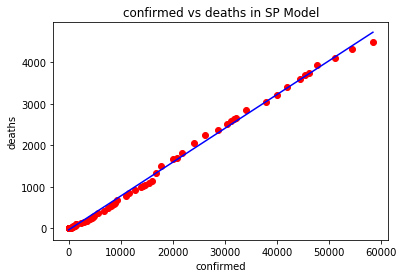

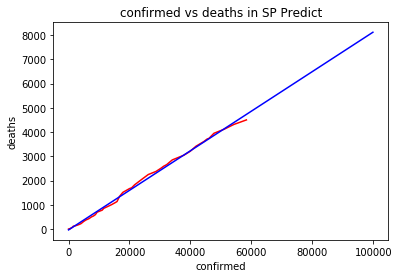

In [0]:
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler

scaler = StandardScaler().fit(df_corr[['deaths']])

x = scaler.transform(df_corr[['confirmed']])
y = scaler.transform(df_corr[['deaths']])

x_new = pd.DataFrame(range(60000, 100000, 100))
x_new = scaler.transform(x_new)

# # Create linear regression object
regr = LinearRegression()

# # Train the model 
regr.fit(x, y)

# # Make predictions 
y_pred = regr.predict(x)

#RMSE
from sklearn.metrics import mean_squared_error
rmse = np.sqrt(mean_squared_error(y, y_pred))
print('RMSE ', rmse)

x = scaler.inverse_transform(x)
y = scaler.inverse_transform(y)
y_pred = scaler.inverse_transform(y_pred)

y_pred_new = regr.predict(x_new)
y_pred_new = scaler.inverse_transform(y_pred_new)
x_new = scaler.inverse_transform(x_new)

import matplotlib.pyplot as plot
plot.scatter(x, y, color = 'red')
plot.plot(x, y_pred, color = 'blue')
plot.title('confirmed vs deaths in SP Model')
plot.xlabel('confirmed')
plot.ylabel('deaths')
plot.show()

x_plot = pd.concat([pd.DataFrame(x), pd.DataFrame(x_new)])
y_plot = pd.concat([pd.DataFrame(y_pred), pd.DataFrame(y_pred_new)])

plot.plot(x, y, color = 'red')
plot.plot(x_plot, y_plot, color = 'blue')
plot.title('confirmed vs deaths in SP Predict')
plot.xlabel('confirmed')
plot.ylabel('deaths')
plot.show()

linear regression BR

,confirmed,deaths
confirmed,1.000000,0.999478
deaths,0.999478,1.000000


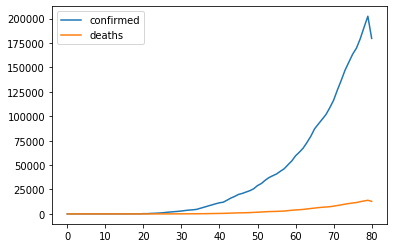

In [0]:
#The two variables are well correlated
df_corr = pd.DataFrame()
covid = pd.DataFrame()

df_br = data.groupby('date').sum()['confirmed'].reset_index()
df_br = df_br.drop('date',axis=1)
covid_confirmed = pd.concat([covid, df_br], ignore_index= False, axis=1)

df_br = data.groupby('date').sum()['deaths'].reset_index()
df_br = df_br.drop('date',axis=1)
covid_deaths = pd.concat([covid, df_br], ignore_index= False, axis=1)

df_br         = pd.DataFrame()
df_br         = pd.concat([df_corr, covid_confirmed, covid_deaths], ignore_index=True, axis=1)
df_br.columns = ['confirmed', 'deaths']

df_br.plot()
df_br.corr(method='pearson') 

RMSE  0.03231402606740922


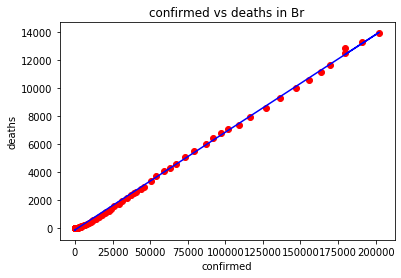

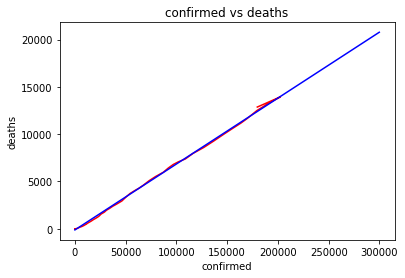

In [0]:
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler

scaler = StandardScaler().fit(df_br[['deaths']])

x = scaler.transform(df_br[['confirmed']])
y = scaler.transform(df_br[['deaths']])

x_new = pd.DataFrame(range(200000, 300000, 100))
x_new = scaler.transform(x_new)

# # Create linear regression object
regr = LinearRegression()

# # Train the model 
regr.fit(x, y)

# # Make predictions 
y_pred = regr.predict(x)

#RMSE
from sklearn.metrics import mean_squared_error
rmse = np.sqrt(mean_squared_error(y, y_pred))
print('RMSE ', rmse)

x = scaler.inverse_transform(x)
y = scaler.inverse_transform(y)
y_pred = scaler.inverse_transform(y_pred)

y_pred_new = regr.predict(x_new)
y_pred_new = scaler.inverse_transform(y_pred_new)
x_new = scaler.inverse_transform(x_new)

import matplotlib.pyplot as plot
plot.scatter(x, y, color = 'red')
plot.plot(x, y_pred, color = 'blue')
plot.title('confirmed vs deaths in Br Model')
plot.xlabel('confirmed')
plot.ylabel('deaths')
plot.show()

x_plot = pd.concat([pd.DataFrame(x), pd.DataFrame(x_new)])
y_plot = pd.concat([pd.DataFrame(y_pred), pd.DataFrame(y_pred_new)])

plot.plot(x, y, color = 'red')
plot.plot(x_plot, y_plot, color = 'blue')
plot.title('confirmed vs deaths in Br Predict')
plot.xlabel('confirmed')
plot.ylabel('deaths')
plot.show()